<a href="https://colab.research.google.com/github/maArpit/ML_projects/blob/master/WGAN/wgan_mnist.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
import numpy as np
import matplotlib.pyplot as plt
import torch
import torch.nn as nn
from torch.utils.data import DataLoader
from torchvision import datasets, transforms
import torch.optim as optim
from torchvision.utils import make_grid

In [ ]:
class Generator(nn.Module):
    def __init__(self):
        super(Generator, self).__init__()

        self.features_to_image = nn.Sequential(
            nn.ConvTranspose2d(64, 32, 4, 2, 1),
            nn.LeakyReLU(0.2),
            nn.BatchNorm2d(32),
            nn.ConvTranspose2d(32, 16, 4, 2, 1),
            nn.LeakyReLU(0.2),
            nn.BatchNorm2d(16),
            nn.ConvTranspose2d(16, 1, 4, 2, 1),
            nn.Sigmoid()
        )

        self.noise_to_features = nn.Sequential(
            nn.ConvTranspose2d(128, 32, 4, 1, 0),
            nn.LeakyReLU(0.2)
        )

        self.class_to_features = nn.Sequential(
            nn.ConvTranspose2d(10, 32, 4, 1, 0),
            nn.LeakyReLU(0.2)
        )
    
    def forward(self, x, cy):
        return self.features_to_image(torch.cat((self.noise_to_features(x), self.class_to_features(cy)), 1))


In [ ]:
class Discriminator(nn.Module):
    def __init__(self):
        super().__init__()
        self.img_to_score = nn.Sequential(
            nn.Conv2d(11, 16, 4, 2, 1),
            nn.LeakyReLU(0.2),
            nn.Conv2d(16, 32, 4, 2, 1),
            nn.LeakyReLU(0.2),
            nn.Conv2d(32, 64, 4, 2, 1),
            nn.LeakyReLU(0.2),
            nn.Conv2d(64, 1, 4, 1, 0),
            nn.LeakyReLU(0.2)
        )

    def forward(self, x, cy):
        x = self.img_to_score(torch.cat((x, cy), 1))
        return x

In [ ]:
all_transforms = transforms.Compose([
        transforms.Resize(32),
        transforms.ToTensor()
    ])
traindata = datasets.MNIST('../data', train=True, download=True, transform=all_transforms)
trainloader = DataLoader(traindata, batch_size=128, shuffle=True)

In [ ]:
# Generator G
G = Generator()

# Critic D
D = Discriminator()

# Gradient penelty coefficient
lmbda = 10

# learning rate alpha and adam optim parameters
alpha, beta1, beta2 = 0.0001, 0, 0.9

# Generator and Critic optim
G_optim = optim.Adam(G.parameters(), lr=alpha, betas=(beta1, beta2))
D_optim = optim.Adam(D.parameters(), lr=alpha, betas=(beta1, beta2))

# critic iterations
n_critic = 5

# epochs
epochs = 20

fixed_noise = torch.randn(10, 128, 1, 1)

In [ ]:
def gradient_penalty(real_data, generated_data, cy1, cy2):
    batch_size = real_data.size()[0]

    t = torch.randn((batch_size, 1, 1, 1), requires_grad=False).expand_as(real_data)
    #print(t.shape, real_data.shape)
    interpolated = t * real_data.data + (1 - t) * generated_data.data
    interpolated.requires_grad = True
    real_data.requires_grad = True
    score = D(interpolated, cy2)
    gradients = torch.autograd.grad(outputs=score, inputs=interpolated, 
                                    grad_outputs=torch.ones(score.size()),
                                    create_graph=True, retain_graph=True)[0]
    gradients = gradients.view(batch_size, -1)
    gradients_norm = torch.sqrt(torch.sum(gradients ** 2, dim=1) + 1e-12)
    #print(lmbda * ((gradients_norm - 1) ** 2).mean())
    return lmbda * ((gradients_norm - 1) ** 2).mean()

def onehot(y):
    batch_size = y.size()[0]
    cy1 = torch.zeros(batch_size, 10, 1, 1)
    cy2 = torch.zeros(batch_size, 10, 32, 32)
    ones = torch.ones(32, 32)
    for i in range(batch_size):
        cy1[i,y[i],:,:] = 1
        cy2[i,y[i]] = ones
    
    '''
    print(cy1)
    print(cy2)
    print(cy1.shape, cy2.shape)
    '''
    return cy1, cy2

In [ ]:
'''
D_loss = []
G_loss = []
iter = 0
img_list = []
'''
for epoch in range(100):
    for i, data in enumerate(trainloader):
        iter += 1
        #print(data[0])
        batch_size = data[0].size()[0]
        x = data[0].view(-1, 1, 32, 32)
        z = torch.randn(batch_size, 128, 1, 1)
        cy1, cy2 = onehot(data[1])
        gx = G(z, cy1)
        #print(gx.shape, x.shape)
        #print(x.shape, gx.shape)
        gp = gradient_penalty(x, gx, cy1, cy2)
        D_optim.zero_grad()
        d_loss = D(gx.detach(), cy2).mean() - D(x, cy2).mean() + gp
        d_loss.backward()
        D_optim.step()
        D_loss.append(-d_loss.item())

        if iter % n_critic == 0:
            gx = G(z, cy1)
            G_optim.zero_grad()
            g_loss = -D(gx, cy2).mean()
            g_loss.backward()
            G_optim.step()
            G_loss.append(g_loss.item())

        if iter % 1000 == 0:
            with torch.no_grad():
                classes = torch.eye(10)
                fake = []
                for c in classes:
                    for noise in fixed_noise:
                        fake.append(G(noise.unsqueeze(0), c.view(1, 10, 1, 1)).detach())
                img_list.append(make_grid(torch.stack(fake).view(100, 1, 32, 32), nrow=10, padding=2, normalize=True))

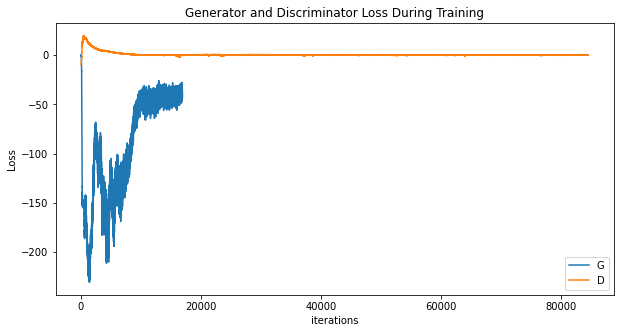

In [ ]:
plt.figure(figsize=(10,5))
plt.title("Generator and Discriminator Loss During Training")
plt.plot(G_loss,label="G")
plt.plot(D_loss,label="D")
plt.xlabel("iterations")
plt.ylabel("Loss")
plt.legend()
plt.show()

Animation size has reached 21197888 bytes, exceeding the limit of 20971520.0. If you're sure you want a larger animation embedded, set the animation.embed_limit rc parameter to a larger value (in MB). This and further frames will be dropped.


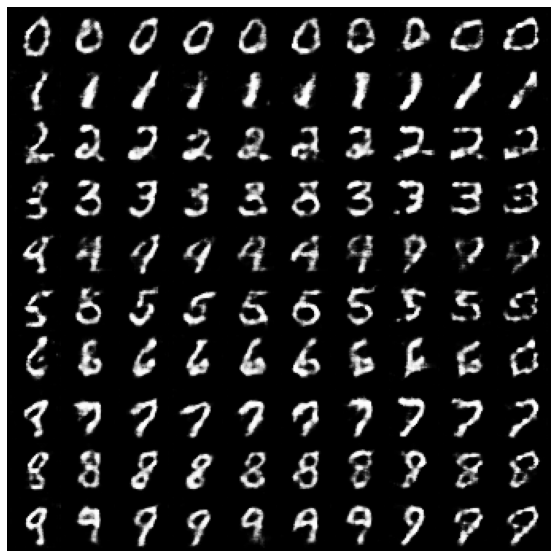

In [ ]:
import matplotlib.animation as animation
from IPython.display import HTML
fig = plt.figure(figsize=(10,10))
plt.axis("off")
ims = [[plt.imshow(np.transpose(i,(1,2,0)), animated=True)] for i in img_list]
ani = animation.ArtistAnimation(fig, ims, interval=1000, repeat_delay=10, blit=True)

HTML(ani.to_jshtml())

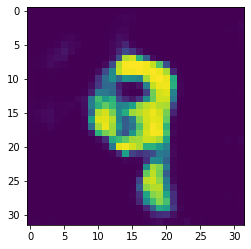

In [ ]:
n1 = torch.randn(1, 128, 1, 1)
cy = torch.zeros(10)
cy[9] = 1
plt.imshow(G(n1, cy.view(1, 10, 1, 1)).detach()[0][0])